# HEAT EQUATION (1-dim) with DIRICHLET BOUNDARY CONDITIONS

### Given by:

$$
\large
\begin{aligned}
&u_{t} = ku_{xx}, \quad 0 < x < \ell , \; t > 0 \\
&u(x,0) = \phi(x), \quad 0 < x < \ell \\
&u(0,t) = g(t), \quad u(\ell, t) = h(t), \quad t > 0 \\
\end{aligned}
$$

To solve numerically, we can use finite difference method, where we descretize the space-time domain, $\Omega$, into a grid and instead of calculating the continuous derivative, we calculate the derivative at each node in the grid by a difference of its neighboring nodes. This transforms the PDE into a system of equations that can then be solved numerically. Dircihlet boundary conditions also anchor our endpoints.

$$
\begin{aligned}
&u_{t} = \frac{u^{n+1}_{j} - u^{n}_{j}}{\Delta t} \\
&ku_{xx} = k\frac{u^{n}_{j+1} - 2u^{n}_{j} + u^{n}_{j-1}}{(\Delta x)^{2}} \\
&\text{where n, j are time, space indices} \\ \\ 
&\text{so setting these equations equal to each other, 
we want to march forward in time to solve this pde, so we solve for n+1th entry} \\ \\
&u^{n+1}_j = s(u^{n}_{j+1} + u^{n}_{j-1}) + (1-2s)(u^{n}_{j}) \\ \\ 
&\text{where} \; s = \frac{k\Delta t}{(\Delta x)^{2}} \; \text{with constraint that} \; s \leq \frac{1}{2} \; \text{to ensure stability of solution} \\
&\text{this is how we fill out our solution matrix after setting the appropriate initial and boundary conditions}
\end{aligned}
$$

In [10]:
from utils import *

In [11]:
def heat_equation_solver_dirichlet(x, t, s, init_cond, g, h):
    '''
    x: space domain (i.e., length of rod)
    t: time domain
    s: mesh factor
    init_cond: initial condition
    g: dirichlet boundary condition 
    h: dirichlet boundary condition
    '''
    u = np.zeros((len(t), len(x)))
    u[0, :] = init_cond
    u[:, 0] = g
    u[:, -1] = h

    J = len(x) - 2
    for n in range(0, len(u) - 1):
        for j in range(1, len(x) - 1):
            u[n+1, j] = s*(u[n, j+1] + u[n, j-1]) + (1-2*s)*u[n,j]

    return u

In [12]:
#optimized version
def heat_equation_solver_dirichlet_optimized(x, t, s, init_cond, g, h):
    u = np.zeros((len(t), len(x)))
    u[0, :] = init_cond
    u[:, 0] = g
    u[:, -1] = h

    J = len(x) - 1
    for n in range(0, len(u) - 1):
        u[n+1, 1:J] = s*(u[n, 2:J+1] + u[n, 0:J-1]) + (1-2*s)*u[n,1:J]

    return u

In [13]:
k = 1 #thermal constant
dx = .01 # mesh size for spatial variable
s = .5 # mesh factor, needs to be <= .5 to ensure stability of solution
dt = s*dx**2 # mesh size for time variable

x0 = 0 # spatial starting point
xL = 1 # spatial ending point

t0 = 0 # time starting point
tL = 1 # time starting point

x = np.arange(x0, xL+dx, dx) # space array
t = np.arange(t0, tL+dt, dt) #time array

init_cond = np.sin(np.pi * x) #initial condition
# dirichlet bc
g = 0 
h = 0
#solution
u = heat_equation_solver_dirichlet_optimized(x, t, s, init_cond, g, h)

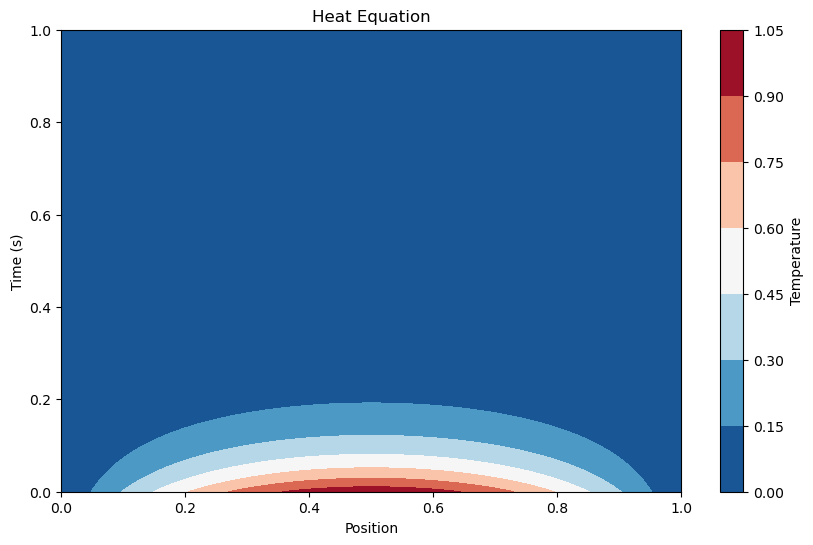

In [14]:
plot(x, t, u, is_heat=True)

$
\text{plot shows that solution converges to zero after about .2 seconds. The next plot shows a better visual of what is really happening}
$

In [15]:
ani = animated_plot(x, t, u, is_dirichlet=True, is_heat=True)
HTML(ani.to_jshtml())

/Users/spencer.bernal/miniforge3/envs/PDE_SOLVER/lib/python3.13/site-packages/matplotlib/animation.py:908: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


RMSE: 1.8422250839706673e-05


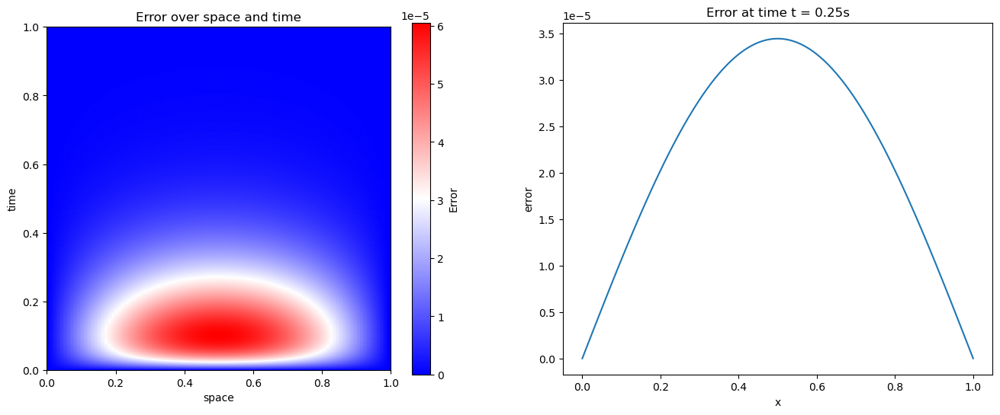

In [16]:
def analytic_solution_heat_eq(x,t):
    X,T = np.meshgrid(x,t)
    return np.exp(-1*(np.pi**2)*T)*np.sin(np.pi*X)

analytic_solution = analytic_solution_heat_eq(x, t)
err = analytic_solution - u
N = err.size
L2 = np.sqrt(np.sum(err**2) / N)
print(f'RMSE: {L2}')

fig, ax = plt.subplots(1,2, figsize= (16,6))
im = ax[0].imshow(err, origin='lower',
           extent=[x.min(), x.max(), t.min(), t.max()],
           cmap='bwr')
fig.colorbar(im, label='Error')
ax[0].set_xlabel('space')
ax[0].set_ylabel('time')
ax[0].set_title('Error over space and time')

fixed_t = len(t)//4
err_line = analytic_solution[fixed_t, :] - u[fixed_t, :]
ax[1].plot(x, err_line)
ax[1].set(xlabel='x', ylabel='error', title= f'Error at time t = {t[fixed_t]}s')
plt.show()

$
\begin{aligned}
&\text{The PDE:} \\
&u_{t} = u_{xx}, \; 0 \lt x \lt 1, \; t > 0 \\
&u(x,0) = sin(\pi x) \\
&u(0, t) =  u(1, t) = 0 \\
&\text{Will have an analytic solution of form} \; u(x,t) = e^{-\pi^{2}t}sin(\pi x) \\
&\text{Comparing the analytical solution to the numerical solution we see that finite difference is extremely accurate with an RMSE} \sim .00001 \\
&\text{We see that the greatest error is concentrated in the first moments of the solution function,} \\ 
&\text{which makes sense because the function is decaying exponentially, and the pointwise derivative shows that the greatest rate of change is at the beginning.}
\end{aligned}
$

# HEAT EQUATION with NEUMANN BOUNDARY CONDITIONS

### Given by

$$
\large
\begin{aligned}
&u_{t} = ku_{xx}, \quad 0 < x < \ell , \; t > 0 \\
&u(x,0) = \phi(x), \quad 0 < x < \ell \\
&u_{x}(0,t) = g(t), \quad u_{x}(\ell, t) = h(t), \quad t > 0 \\
\end{aligned}
$$

$
\begin{aligned}
&\text{Not much changes here from the way we approached the dirichlet case,} \\
&\text{except here we must express the boundary conditions using a finite difference and update as we proceed along the solution matrix} \\
&\frac{u^{n}_{1} - u^{n}_{-1}}{2\Delta x} = g^{n} \\
&\frac{u^{n}_{\ell + 1} - u^{n}_{\ell - 1}}{2\Delta x} = h^{n} \\
&\text{we introduce ghost points}, u^{n}_{\ell + 1}, u^{n}_{-1}, \;  \text{for derivatives on the boundary} \\
&\text{for} \; u^{n}_{0}, ..., u^{n}_{\ell} \; \text{we fill in these entries using the scheme for the PDE, and then calculate the ghost value points} \\
&\text{using above equations to ultimately fill in boundary values}
\end{aligned}
$

In [17]:
def heat_equation_solver_neumann(x, t, s, init_cond, g, h):
    '''
    x: space domain (i.e., length of rod)
    t: time domain
    s: mesh factor
    init_cond: initial condition (heat at time 0)
    g: neumann boundary condition
    h: neumann boundary condition
    '''
    u = np.zeros((len(t), len(x)))
    dx = x[1] - x[0]
    u[0, :] = init_cond
    L = len(x) - 1
    for n in range(0, len(u) - 1):
        u[n+1, 0] = s*(u[n, 1] + u[n, 1] - 2*dx*g[n]) + (1-2*s)*u[n, 0]
        u[n+1, L] = s*(u[n, L-1] + 2*dx*h[n] + u[n, L-1]) + (1-2*s)*u[n, L] 
        for j in range(1, len(x) - 1):
            u[n+1, j] = s*(u[n, j+1] + u[n, j-1]) + (1-2*s)*u[n,j]

    return u

In [18]:
def heat_equation_solver_neumann_optimized(x, t, s, init_cond, g, h):
    u = np.zeros((len(t), len(x)))
    u[0, :] = init_cond
    
    for n in range(0, len(u) - 1):
        u[n+1, 0] = s*(u[n, 1] + u[n, 1] - 2*dx*g[n]) + (1-2*s)*u[n, 0]
        u[n+1, -1] = s*(u[n, -2] + 2*dx*h[n] + u[n, -2]) + (1-2*s)*u[n, -1] 
        
        u[n+1, 1:-1] = s*(u[n, 2:] + u[n, :-2]) + (1-2*s)*u[n,1:-1]

    return u

In [19]:
dx = .01 # mesh size for spatial variable
s = .5 # mesh factor, needs to be <= .5 to ensure stability of solution
dt = s*dx**2 # mesh size for time variable

x0 = 0 # spatial starting point
xL = 1 # spatial ending point

t0 = 0 # time starting point
tL = 1 # time starting point

x = np.arange(x0, xL+dx, dx) # space array
t = np.arange(t0, tL+dt, dt) #time array

init_cond = np.cos(np.pi * x) #initial condition

g = [0 for _ in range(len(t))]#homogeneous neumann
h = g
u = heat_equation_solver_neumann_optimized(x, t, s, init_cond, g, h)

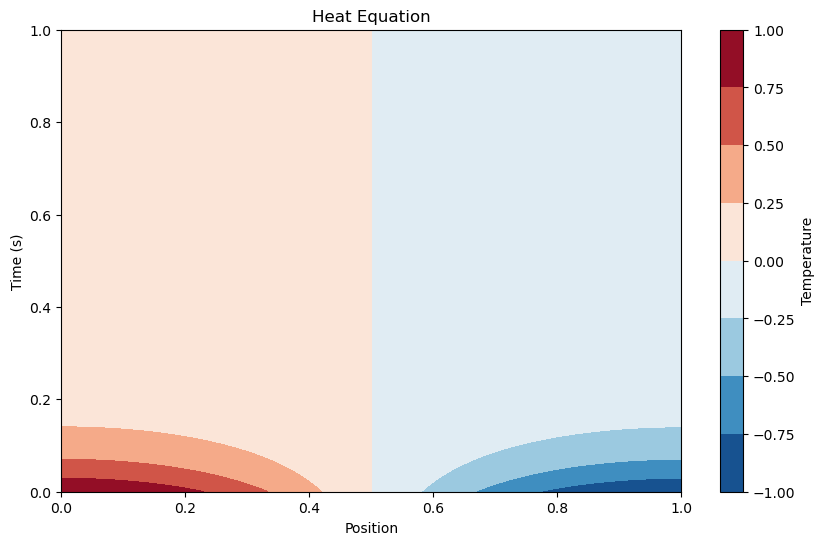

In [20]:
plot(x, t, u, is_heat=True)

In [21]:
ani = animated_plot(x, t, u, is_dirichlet=False, is_heat=True)
HTML(ani.to_jshtml())